# **Modelowanie ruchu ulicznego**

Szymon Malec <br>
Natalia Klepacka <br>
Damian Szuster <br>
Michał Wiktorowski <br>
Filip Oszczepaliński

In [2]:
using DataTables
using Plots
using StatsBase
using Distributions
using StatsFuns
using KernelDensity
using Statistics
using StatsPlots
using CSV
using DataFrames
using LaTeXStrings
using LsqFit
using DelimitedFiles

# Średnia procesu M/M/1 - uzupełnienie

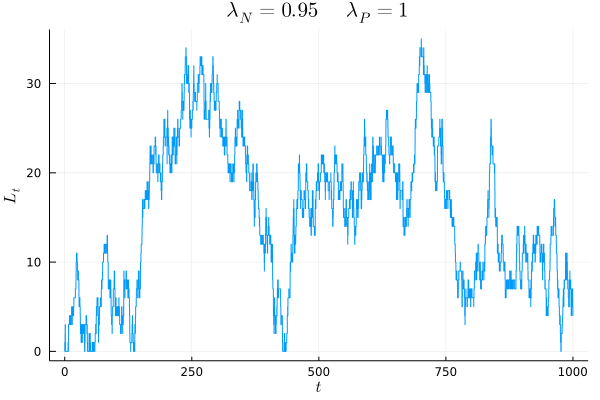

In [72]:
λ_N = 0.95
λ_P = 1
ρ = λ_N / λ_P
T = 1000

Ts_N = sort(rand(Uniform(0, T), rand(Poisson(λ_N * T))))
F_N = ecdf(Ts_N)
N(t) = F_N(t) * length(Ts_N)

Ts_P = Float64[Ts_N[1]]
for t in 0:0.01:T
    if N(t) - length(Ts_P) + 1 > 0.5
        append!(Ts_P, maximum([t, Ts_P[end]]) + rand(Exponential(1/λ_P)) )
    end
end
popfirst!(Ts_P)

F_P = ecdf(Ts_P)
P(t) = F_P(t) * length(Ts_P)
L(t) = N(t) - P(t)

ts = 0:0.01:T
plot(ts, L.(ts), legend=false, xlabel=L"t", ylabel=L"L_t", title=L"\lambda_N = 0.95 \ \ \ \ \ \lambda_P = 1")

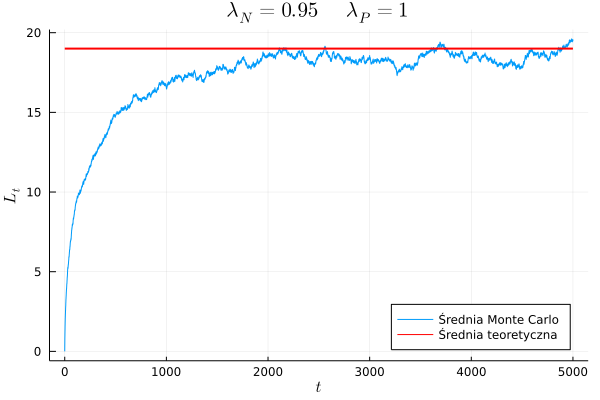

In [73]:
λ_N = 0.95
λ_P = 1
ρ = λ_N / λ_P
T = 5000
ts = 0:0.1:T
MC = 1000

average_Ls = zeros(length(ts))
for i in 1:MC
    Ts_N = sort(rand(Uniform(0, T), rand(Poisson(λ_N * T))))
    F_N = ecdf(Ts_N)
    N(t) = F_N(t) * length(Ts_N)

    Ts_P = Float64[Ts_N[1]]
    for t in 0:0.1:T
        if N(t) - length(Ts_P) + 1 > 0.5
            append!(Ts_P, maximum([t, Ts_P[end]]) + rand(Exponential(1/λ_P)) )
        end
    end
    popfirst!(Ts_P)

    F_P = ecdf(Ts_P)
    P(t) = F_P(t) * length(Ts_P)
    L(t) = N(t) - P(t)
    average_Ls .+= L.(ts)
end

average_Ls ./= MC
plot(ts, average_Ls, label="Średnia Monte Carlo")
plot!(ts, t -> ρ / (1 - ρ), lw=2, c=:red, label="Średnia teoretyczna")
plot!(legend=:bottomright, xlabel=L"t", ylabel=L"L_t", title=L"\lambda_N = 0.95 \ \ \ \ \ \lambda_P = 1")

# Pomiary

<img src="images/pres4_1.png">
<img src="images/pres4_2.png">
<img src="images/pres4_3.jpg">

# Obróbka danych

In [3]:
cars = [126, 134, 156, 124, 161, 129, 154, 150, 151, 153, 123, 125, 116, 115, 139, 106, 98, 107, 108, 114, 104, 93, 119, 82]
data = [[1,12.72,12],
        [2,6.98,8],
        [3,14.69,8],
        [4,9.38,10],
        [5,11.27,11],
        [6,13.43,11],
        [7,11.79,12],
        [8,8.68,11],
        [9,7.20,9],
        [10,8.64,9],
        [11,11.04,10],
        [12,11.58,11],
        [13,12.71,10],
        [14,13.39,11],
        [15,13.29,9],
        [16,6.28,8],
        [17,11.04,9],
        [18,9.05,8],
        [19,12.16,9],
        [20,9.15,8]]
df = DataFrame(index=Int64[], time=Float64[], cars=Int64[])
push!.(Ref(df), data)
df

,index,time,cars
,Int64,Float64,Int64
1,1,12.72,12
2,2,6.98,8
3,3,14.69,8
4,4,9.38,10
5,5,11.27,11
6,6,13.43,11
7,7,11.79,12
8,8,8.68,11
9,9,7.2,9


In [91]:
cars

24-element Vector{Int64}:
 126
 134
 156
 124
 161
 129
 154
 150
 151
 153
   ⋮
 106
  98
 107
 108
 114
 104
  93
 119
  82

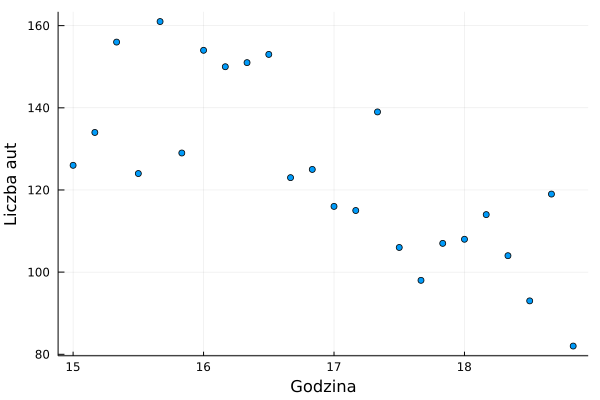

In [95]:
scatter(15 : 1/6 : 19 - 1/6, cars, xlabel="Godzina", ylabel="Liczba aut", legend=false)

In [6]:
function MA(X, n)
    S = Float64[]
    for i in 1 : length(X) - n + 1
        s = mean(X[i : i + n - 1])
        append!(S, s)
    end
    return S
end

MA (generic function with 1 method)

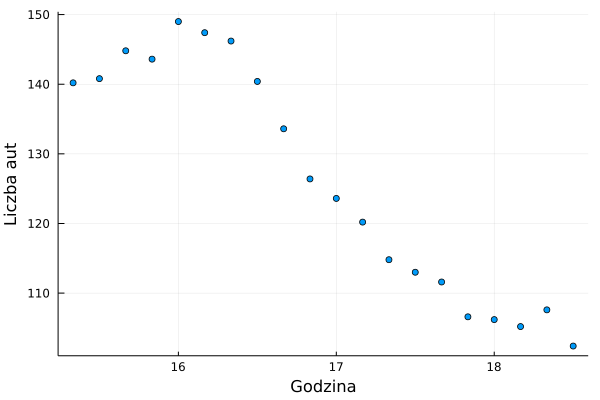

In [101]:
scatter(15 + 2/6 : 1/6 : 19 - 3/6, MA(cars, 5), xticks=15:19, xlabel="Godzina", ylabel="Liczba aut", legend=false)

$$ y(t) = a_3 t^3 + a_2 t^2 + a_1 t + a_0 $$

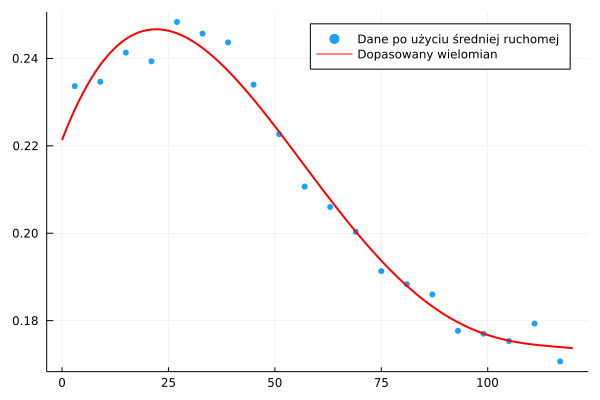

a0 = 0.22132420713278783
a1 = 0.0025363686292275314
a2 = -7.402162178624882e-5
a3 = 5.074937646002667e-7
a4 = -6.5520604879903494e-12


In [102]:
X = 3:6:117
Y = MA(cars, 5) ./ 600

f_mod(t, p) = p[5] .* t.^5 .+ p[4] .* t.^3 .+ p[3] .* t.^2 .+ p[2] .* t .+ p[1]
f_fit = curve_fit(f_mod, X, Y, [1.0, 1.0, 1.0, 1.0, 1.0])

xs = 0:1:120
scatter(X, Y, ms=4, alpha=0.9, markerstrokewidth=0, label="Dane po użyciu średniej ruchomej")
plot!(xs, f_mod(xs, f_fit.param), lw=2, c=:red, label="Dopasowany wielomian") |> display

symbols = ["a0", "a1", "a2", "a3", "a4"]
for param in zip(symbols, f_fit.param) 
    println(param[1], " = ", param[2])
end

In [9]:
v_sr = 40
v_f = 70 / mean(df.time)
r = 70 / mean(df.cars)
n(t) = r/2 * f_mod(t/100, f_fit.param)
g(t) = n(t) / v_sr
p_Z = 3.7
function p(t, T, T_Z)
    if 0 < t % T <= T_Z
        return p_Z
    else
        return 0.0
    end
end

p (generic function with 1 method)

# Dopasowanie modeli do danych

## Model bez opóźnienia

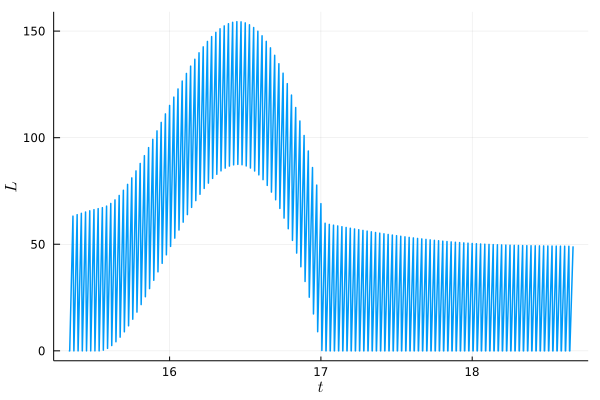

In [123]:
L0 = 0

dt = 1 # Krok czasowy
T = 12000

T_ZC = 100
T_Z = 23

# Wartości L'(t)
dL = dt .* (v_sr .* g.(dt:dt:T) .- p.(dt:dt:T, T_ZC, T_Z)) ./ (1 .- g.(dt:dt:T))

# Metodą Eulera wyliczamy wartości L(t)
Ls = [maximum([0, dL[1]])]
for t in 2dt:dt:T
    index = Int(round(t/dt))
    l = Ls[index-1] + dL[index]
    if l <= 0
        append!(Ls, 0)
    else
        append!(Ls, l)
    end
end

xs = 1/dt .* (dt:dt:T) ./ 3600 .+ 15 .+ 2/6
plot(xs, Ls, xlabel=L"t", ylabel=L"L", lw=1.5, legend=false, xticks=15:19)

## Model z opóźnieniem

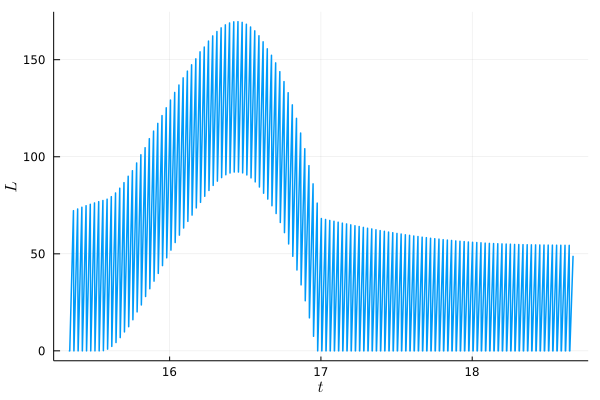

In [124]:
L0 = 0

dt = 0.1 # Krok czasowy
T = 12000

T_ZC = 100
T_Z = 23

# Wartości L'(t)
dL = dt .* (v_sr .* g.(dt:dt:T) .- p.(dt:dt:T, T_ZC, T_Z)) ./ (1 .- g.(dt:dt:T))

# Metodą Eulera wyliczamy wartości L(t)
Ls = Float64[L0]
for t in dt:dt:T-dt
    Δt = Ls[end]/v_f
    dL = dt * (v_sr * g(t - Δt) - p(t - Δt, T_ZC, T_Z)) / (1 - g(t - Δt) - p(t - Δt, T_ZC, T_Z)/v_f)
    l = Ls[end] + dL
    if l <= 0
        append!(Ls, 0)
    else
        append!(Ls, l)
    end
end

xs = (dt:dt:T) ./ 3600 .+ 15 .+ 2/6
plot(xs, Ls, xlabel=L"t", ylabel=L"L", lw=1.5, legend=false, xticks=15:19)

## Porównanie

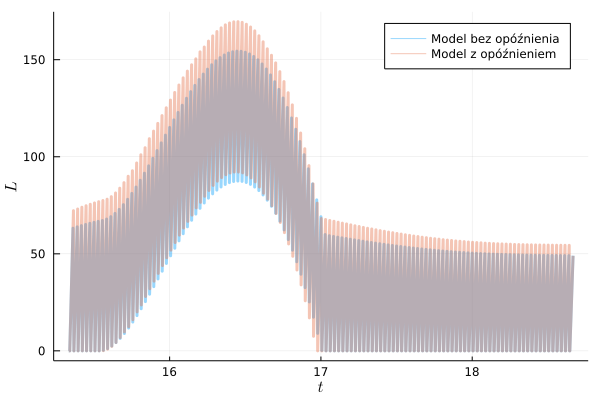

In [125]:
L0 = 0

dt = 0.1 # Krok czasowy
T = 12000

T_ZC = 100
T_Z = 23


# Bez opóźnienia
dL = dt .* (v_sr .* g.(dt:dt:T) .- p.(dt:dt:T, T_ZC, T_Z)) ./ (1 .- g.(dt:dt:T))

Ls1 = [maximum([0, dL[1]])]
for t in 2dt:dt:T
    index = Int(round(t/dt))
    l = Ls1[index-1] + dL[index]
    if l <= 0
        append!(Ls1, 0)
    else
        append!(Ls1, l)
    end
end


# Z opóźnieniem
dL = dt .* (v_sr .* g.(dt:dt:T) .- p.(dt:dt:T, T_ZC, T_Z)) ./ (1 .- g.(dt:dt:T))

Ls2 = Float64[L0]
for t in dt:dt:T-dt
    Δt = Ls2[end]/v_f
    dL = dt * (v_sr * g(t - Δt) - p(t - Δt, T_ZC, T_Z)) / (1 - g(t - Δt) - p(t - Δt, T_ZC, T_Z)/v_f)
    l = Ls2[end] + dL
    if l <= 0
        append!(Ls2, 0)
    else
        append!(Ls2, l)
    end
end

xs = (dt:dt:T) ./ 3600 .+ 15 .+ 2/6
plot(xs, Ls1, xlabel=L"t", ylabel=L"L", label="Model bez opóźnienia", lw=3, alpha=0.4)
plot!(xs, Ls2, xlabel=L"t", ylabel=L"L", label="Model z opóźnieniem", lw=3, alpha=0.4, xticks=15:19)

## Model stochastyczny

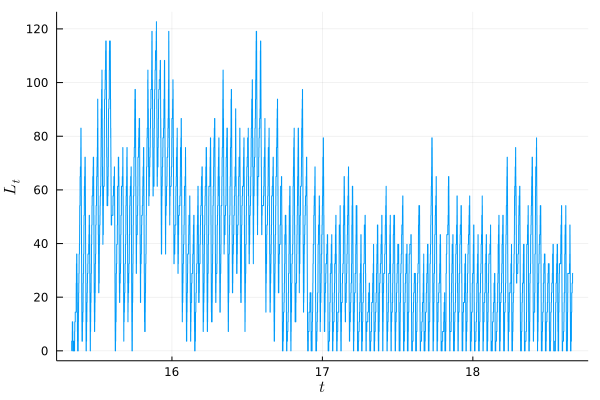

In [134]:
λ(t) = n(t) / (r/2)
λm = maximum(λ.(0:01:T))

T = 12000
Δt = 1/(2 * p_Z / r)
T_ZC = 100
T_Z = 24

Ts_N = sort(rand(Uniform(0, T), rand(Poisson(λm*T))))
Ts_N = [t for t in Ts_N if rand()<λ(t)/λm]
F_N = ecdf(Ts_N)
N(t) = F_N(t) * length(Ts_N)

Ts = Float64[]
for t in T_Z : T_ZC : T
    Ts = vcat(Ts, t + Δt : Δt : t + T_Z)
end

Ts_P = Float64[]
diffs = 0
for t in Ts
    if N(t) - diffs > 0.5
        diffs += 1
        append!(Ts_P, t)
    end
end

F_P = ecdf(Ts_P)
P(t) = F_P(t) * length(Ts_P)
L(t) = (N(t) - P(t)) * r/2

ts = 0.1:0.1:T
xs = ts ./ 3600 .+ 15 .+ 2/6
plot(xs, L.(ts), legend=false, xlabel=L"t", ylabel=L"L_t", xticks=15:19)

## Wartość średnia procesu

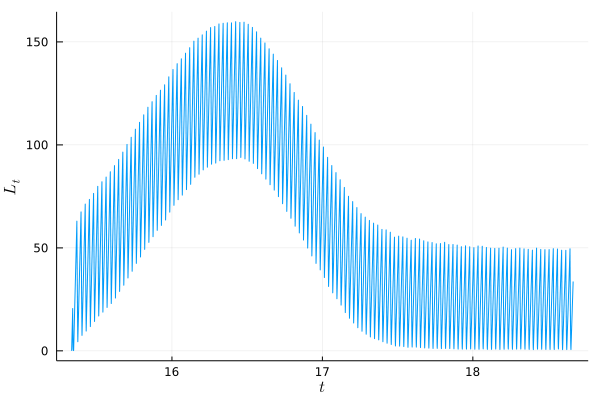

attempt to save state beyond implementation limit


In [136]:
λ(t) = n(t) / (r/2)
λm = maximum(λ.(0:01:T))

T = 12000
Δt = 1/(2 * p_Z / r)
T_ZC = 100
T_Z = 24

ts = 0:0.1:T
avg_Ls = zeros(length(ts))
MC = 1000
for i in 1:MC

    Ts_N = sort(rand(Uniform(0, T), rand(Poisson(λm*T))))
    Ts_N = [t for t in Ts_N if rand()<λ(t)/λm]
    F_N = ecdf(Ts_N)
    N(t) = F_N(t) * length(Ts_N)

    Ts = Float64[]
    for t in T_Z : T_ZC : T
        Ts = vcat(Ts, t + Δt : Δt : t + T_Z)
    end

    Ts_P = Float64[]
    diffs = 0
    for t in Ts
        if N(t) - diffs > 0.5
            diffs += 1
            append!(Ts_P, t)
        end
    end

    F_P = ecdf(Ts_P)
    P(t) = F_P(t) * length(Ts_P)
    L(t) = (N(t) - P(t)) * r/2

    avg_Ls .+= L.(ts)
end
avg_Ls ./= MC

ts = 0:0.1:T
xs = ts ./ 3600 .+ 15 .+ 2/6
plot(xs, avg_Ls, legend=false, xlabel=L"t", ylabel=L"L_t", xticks=15:19)

## Porównanie wszystkich modeli

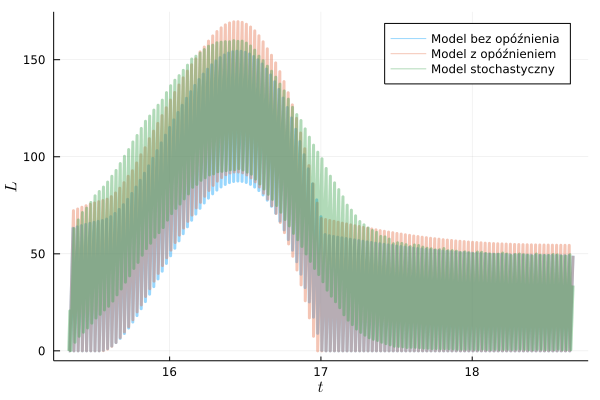

In [139]:
plot((dt:dt:T) ./ 3600 .+ 15 .+ 2/6, Ls1, label="Model bez opóźnienia", lw=3, alpha=0.4)
plot!((dt:dt:T) ./ 3600 .+ 15 .+ 2/6, Ls2, label="Model z opóźnieniem", lw=3, alpha=0.4)
plot!(ts ./ 3600 .+ 15 .+ 2/6, avg_Ls, label="Model stochastyczny", lw=3, alpha=0.4, xlabel=L"t", ylabel=L"L", xticks=15:19)

# 
# <center> **Dziękujemy za uwagę!** </center>
<img src="images/pres4_4.png">